In [1]:
import torch
import os
import numpy as np
import cv2
import scipy

import matplotlib.pyplot as plt

from scipy.ndimage import convolve

In [2]:
%matplotlib inline

%load_ext autoreload
%autoreload 2

In [3]:
from test_batch import box_distance, collect_predict,cache_to_arrowed, test_arrow, draw_predict_single,load_predict,smooth_predict

In [5]:
collected = collect_predict("output003_cache_split", pixel_threshold = 60, verbose=True,
                    K_size = 60, K_delta_size=40)

58 chain detected


In [6]:
sorted([len(chain) for chain in collected['chain_list']], reverse=True)[:20]

[2907,
 1429,
 906,
 658,
 216,
 117,
 115,
 71,
 65,
 47,
 32,
 29,
 19,
 17,
 14,
 12,
 11,
 8,
 7,
 6]

In [8]:
#pt.shape,pt_smoothed.shape,ptc.shape,ptc_smoothed.shape

In [9]:
def plot_trace(x,y, alpha=1.0):
    n = x.shape[0]
    plt.plot(x[:n//3],y[:n//3],'-o',color='r', alpha=alpha)
    plt.plot(x[n//3:n//3*2],y[n//3:n//3*2],'-o',color='g', alpha=alpha)
    plt.plot(x[n//3*2:],y[n//3*2:],'-o',color='b', alpha=alpha)


2907


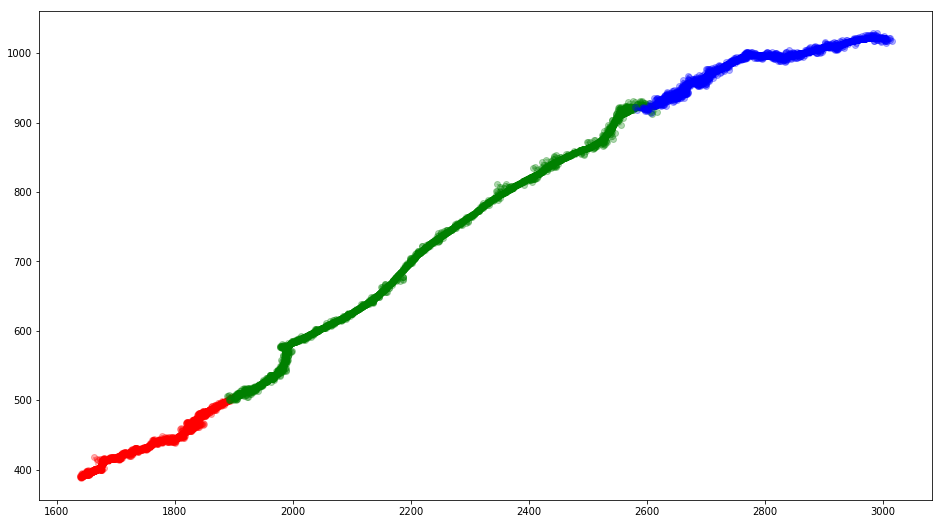

1429


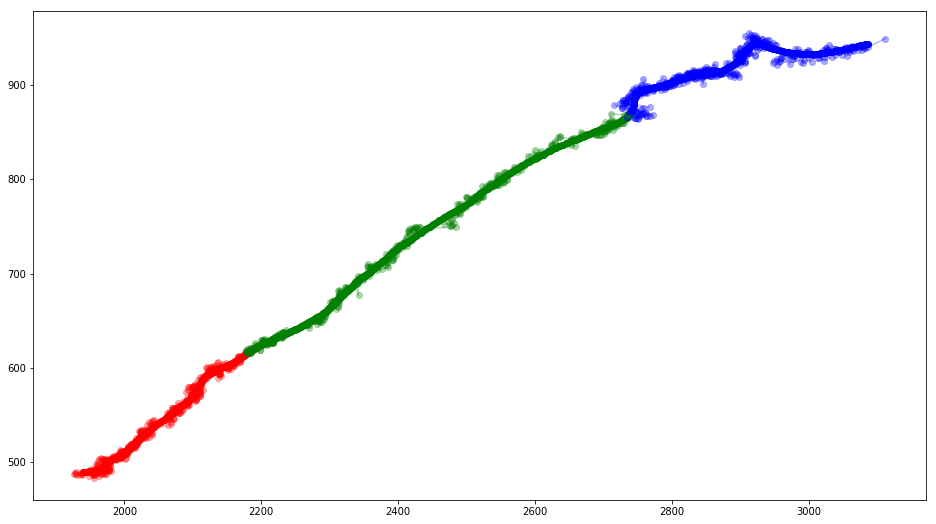

906


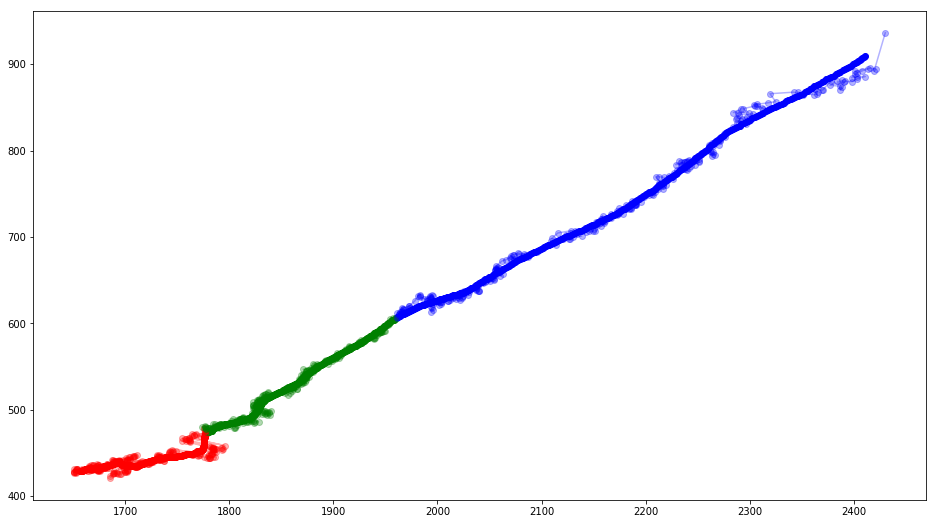

658


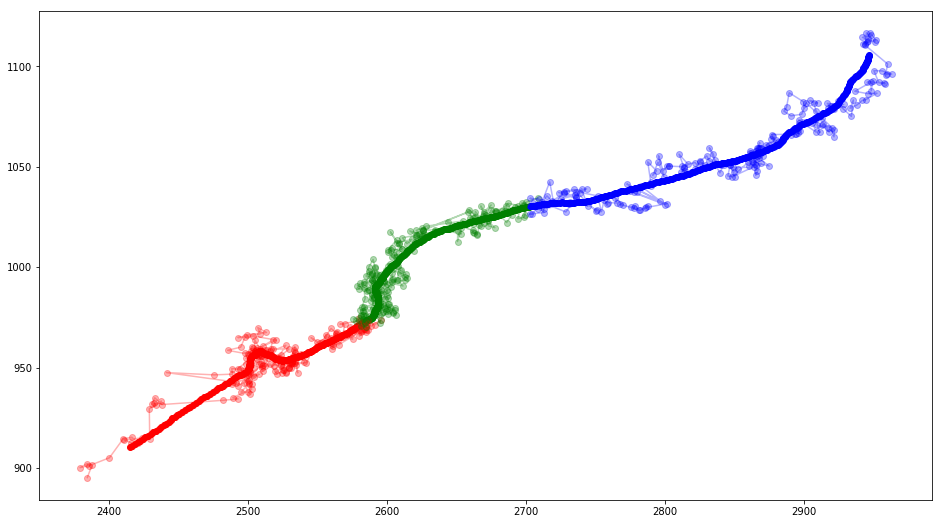

216


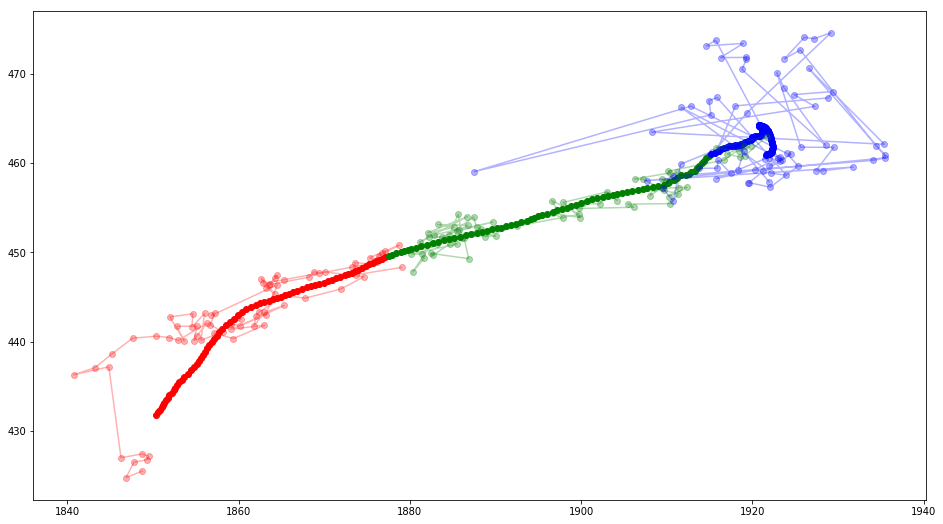

117


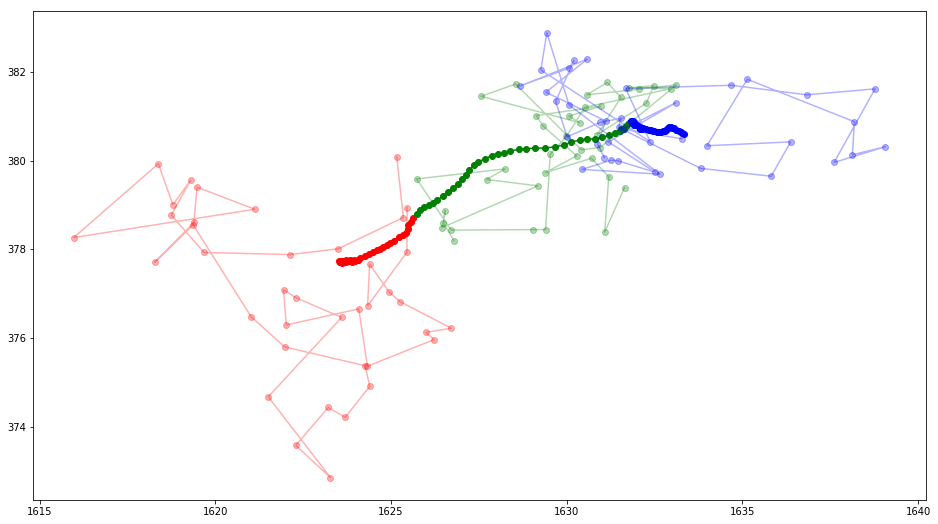

115


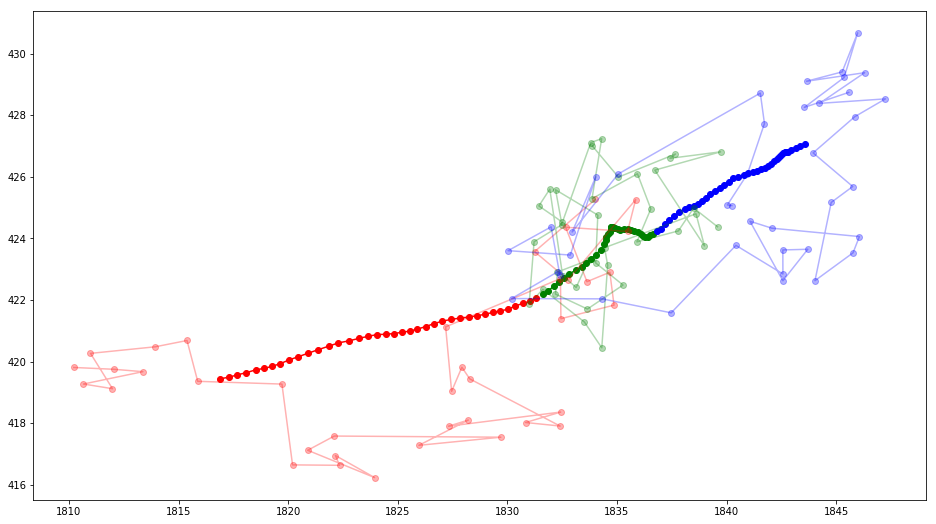

71


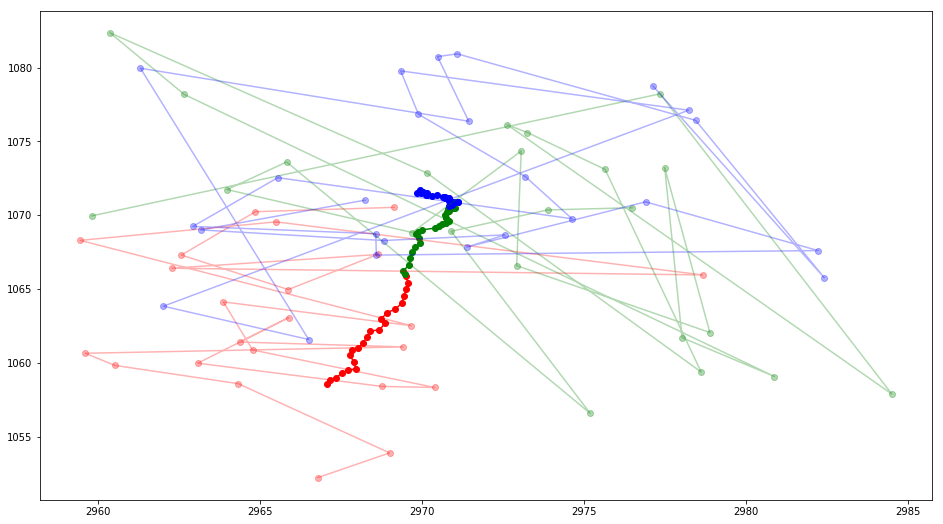

65


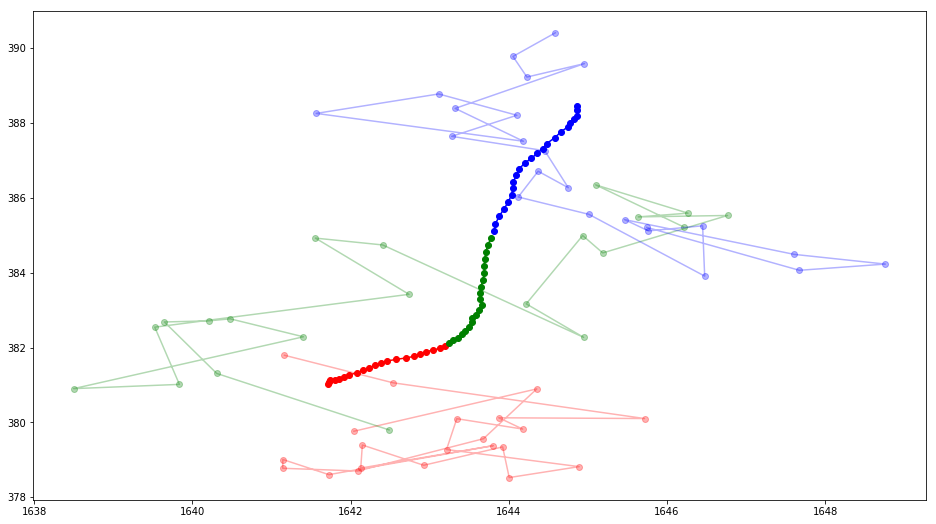

47


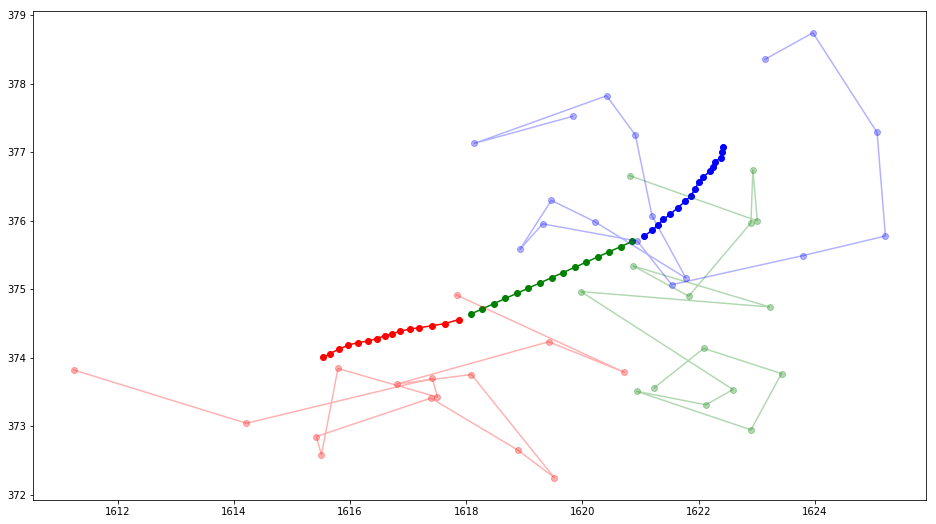

In [10]:
for chain in sorted([chain for chain in collected['chain_list']], reverse=True, key=len)[:10]:
    pt_arr = np.array([box['pt'] for box in chain])
    pt_smoothed_arr = np.array([box['pt_smoothed'] for box in chain])
    if len(pt_arr) <2:
        print('suppressed')
        continue
    print(len(pt_arr))
    x,y = pt_arr[:,::2].mean(axis=1),pt_arr[:,1::2].mean(axis=1)
    x_bar,y_bar = pt_smoothed_arr[:,::2].mean(axis=1),pt_smoothed_arr[:,1::2].mean(axis=1)
    
    plt.figure(figsize=(16,9))
    plot_trace(x_bar, y_bar)
    plot_trace(x,y, alpha=0.3)
    plt.show()

In [11]:
background_bgr = cv2.imread('images/images53.jpg')
background = cv2.cvtColor(background_bgr, cv2.COLOR_BGR2RGB)

2907


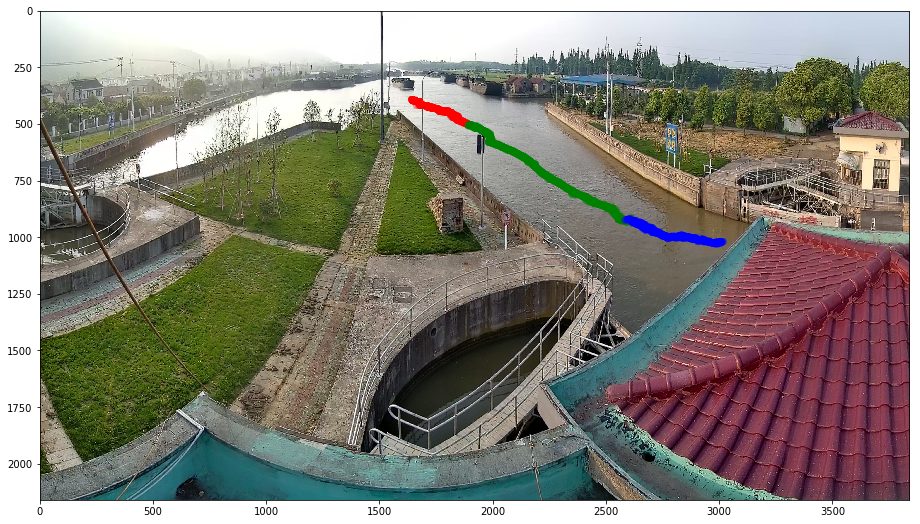

1429


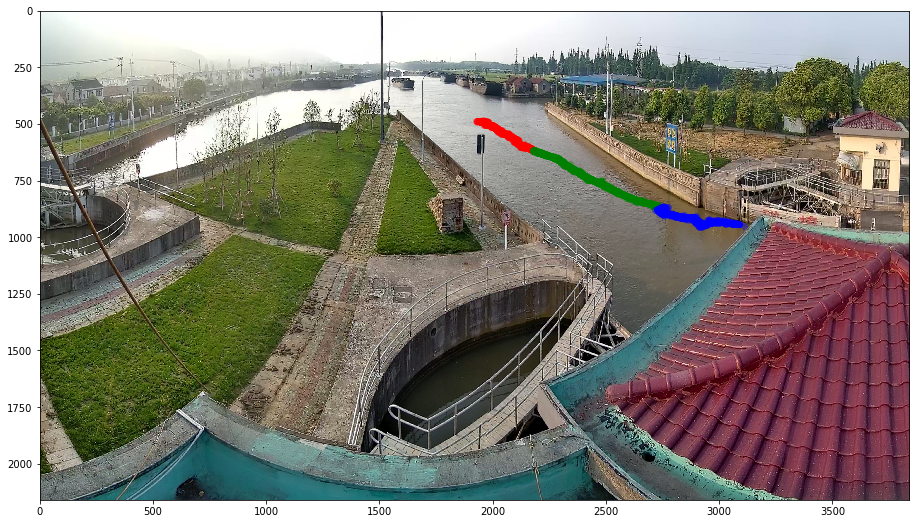

906


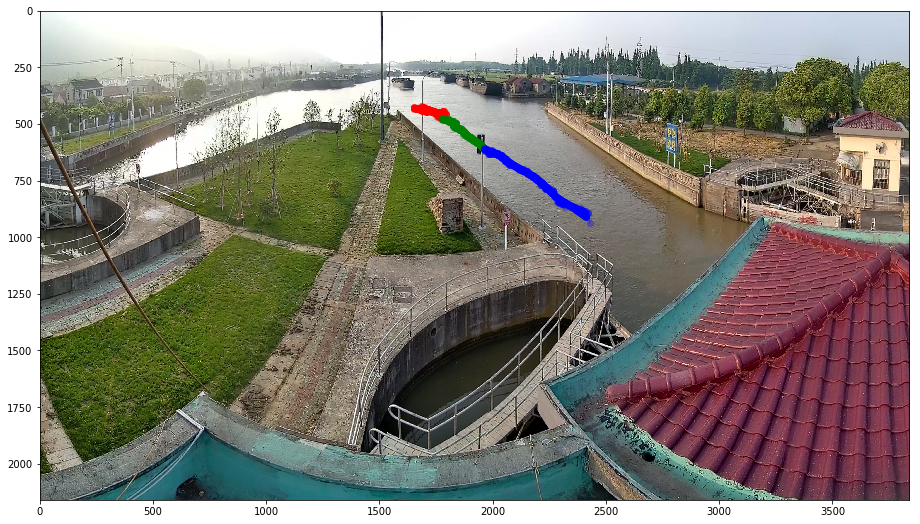

658


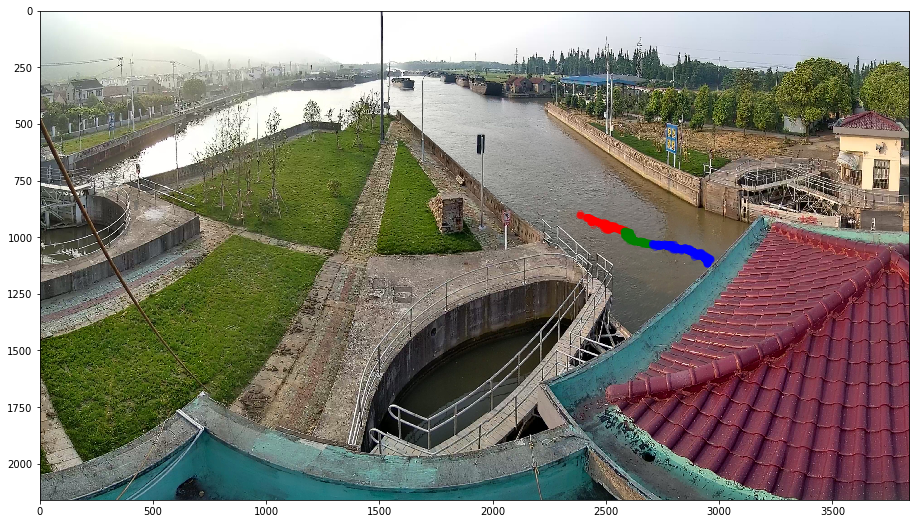

216


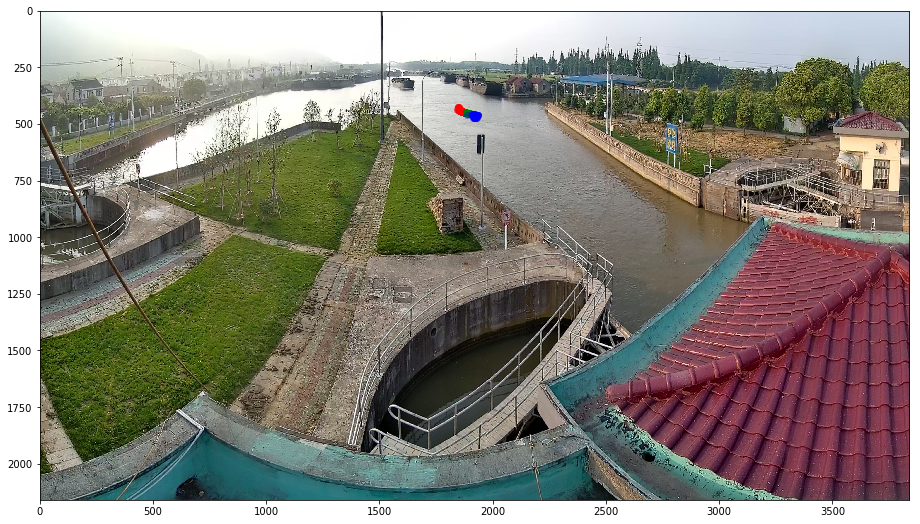

117


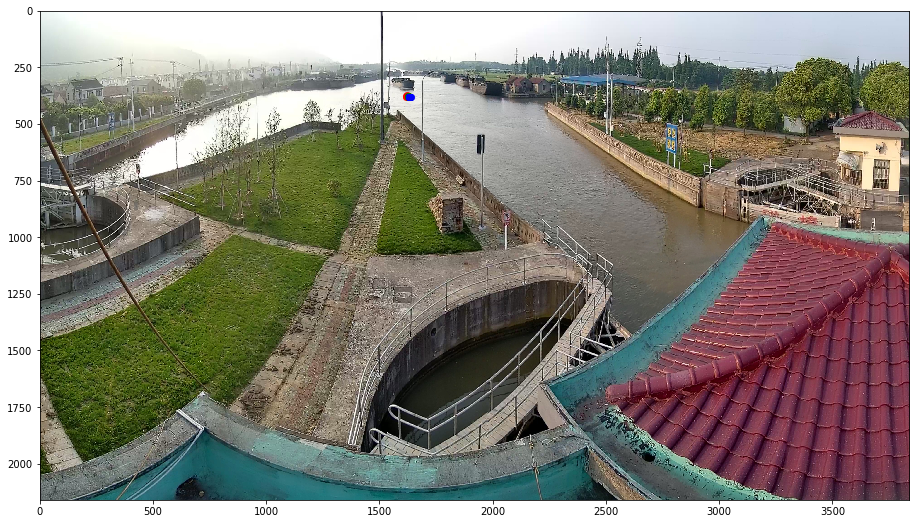

115


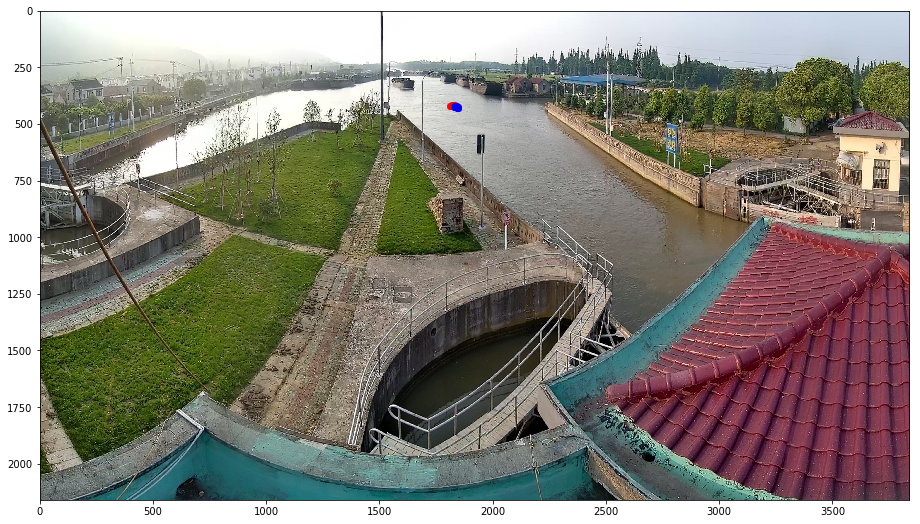

71


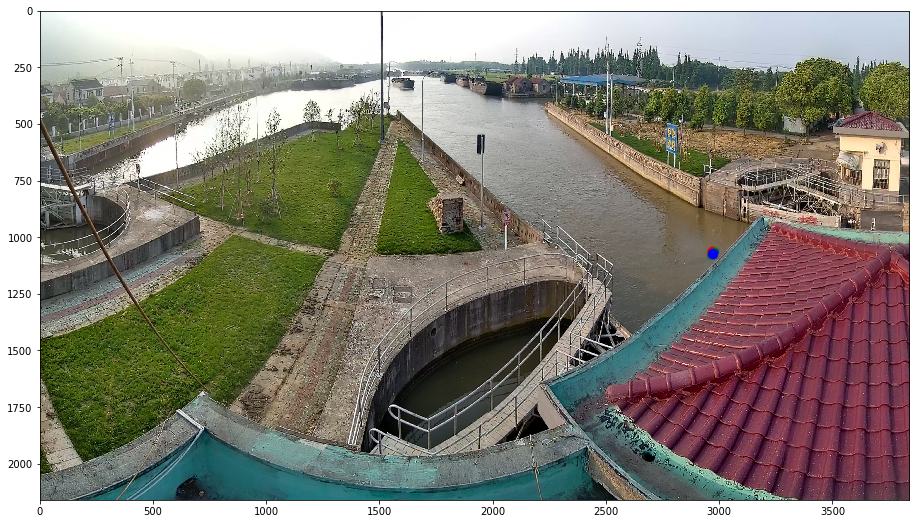

65


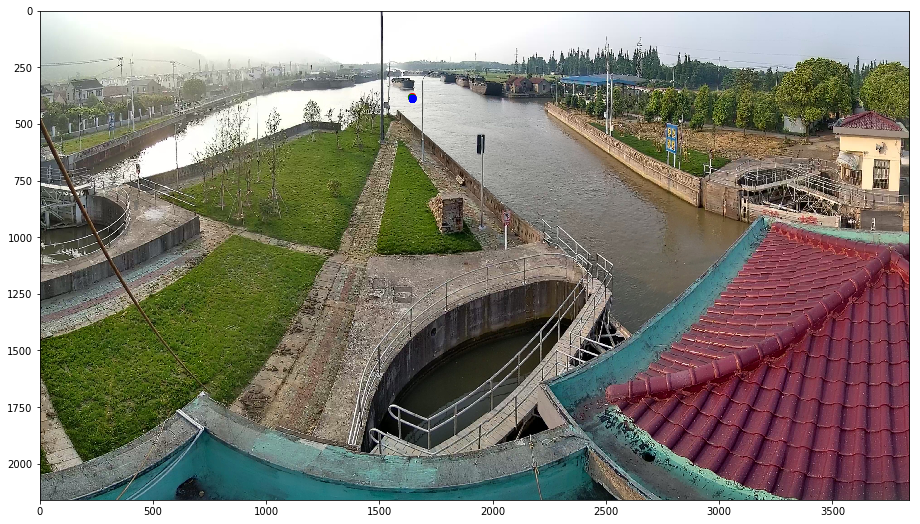

47


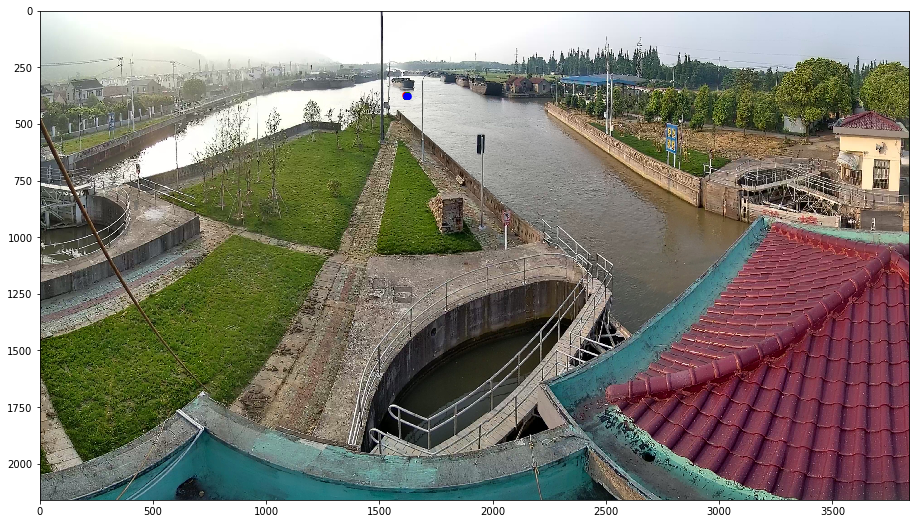

In [12]:
for chain in sorted([chain for chain in collected['chain_list']], reverse=True, key=len)[:10]:
    pt_arr = np.array([box['pt'] for box in chain])
    pt_smoothed_arr = np.array([box['pt_smoothed'] for box in chain])
    if len(pt_arr) <2:
        print('suppressed')
        continue
    print(len(pt_arr))
    x,y = pt_arr[:,::2].mean(axis=1),pt_arr[:,1::2].mean(axis=1)
    x_bar,y_bar = pt_smoothed_arr[:,::2].mean(axis=1),pt_smoothed_arr[:,1::2].mean(axis=1)
    
    plt.figure(figsize=(16,9))
    plot_trace(x_bar, y_bar)
    plot_trace(x,y, alpha=0.3)
    plt.imshow(background)
    plt.show()

In [13]:
def adaptive_chain_smoother(arr):
    n_K = max(len(arr) //2, 1)
    K = np.ones(n_K)/n_K
    return convolve(arr, K, mode ='nearest')

collected = collect_predict("output003_cache_split", pixel_threshold = 60, verbose=True,
                    K_size = 60, K_delta_size=40, chain_smoother = adaptive_chain_smoother)

58 chain detected


2907


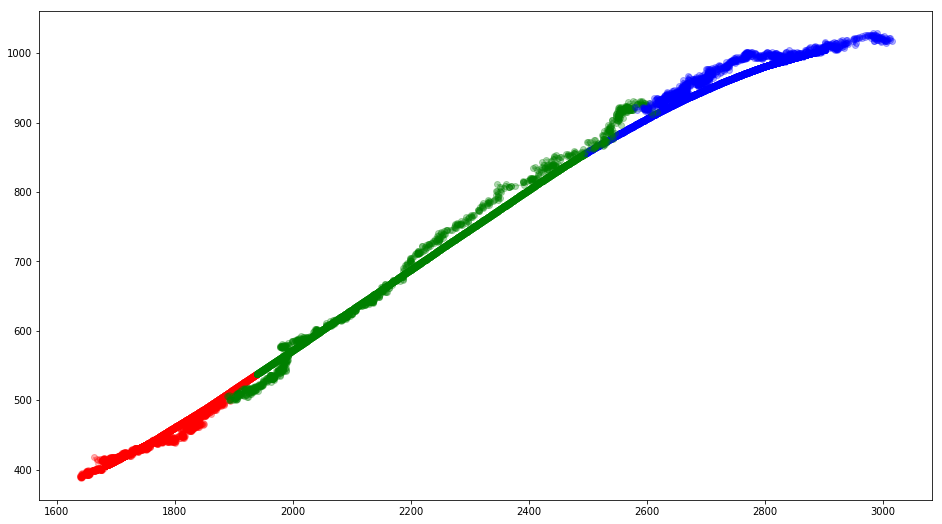

1429


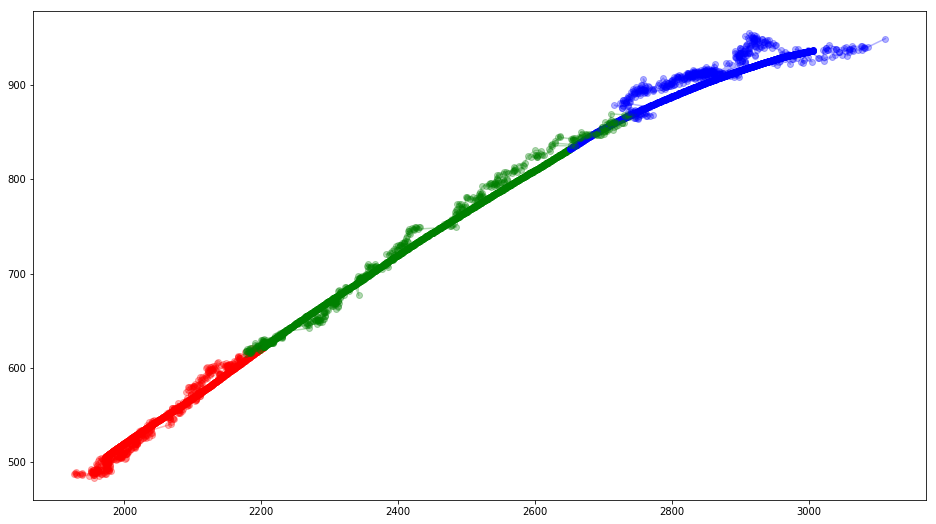

906


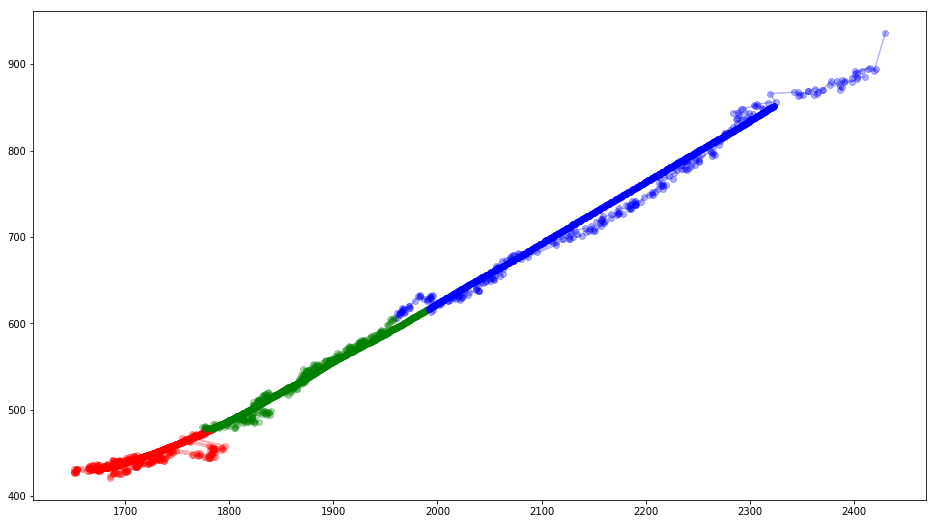

658


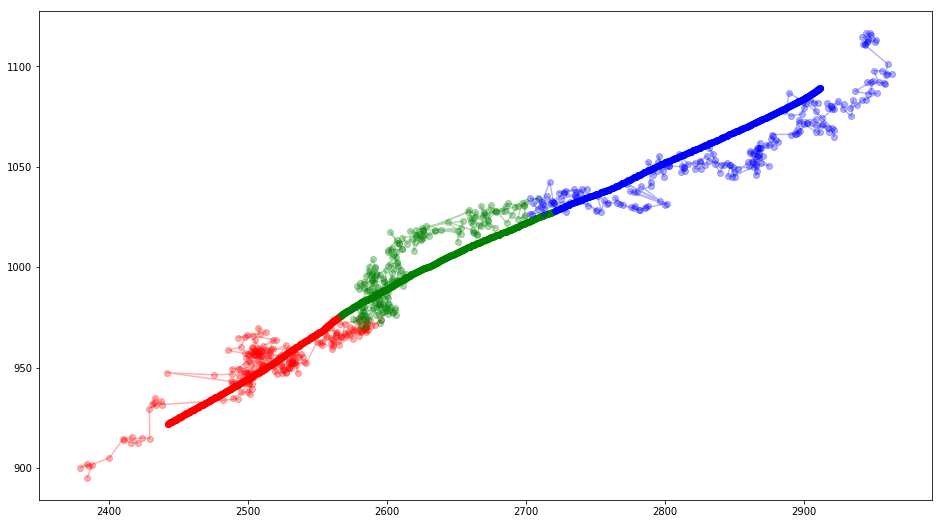

216


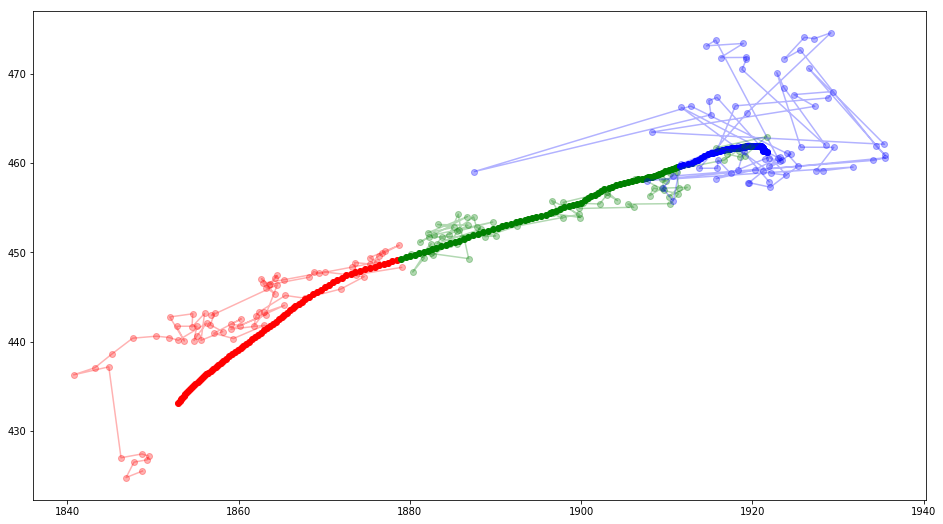

In [14]:
for chain in sorted([chain for chain in collected['chain_list']], reverse=True, key=len)[:5]:
    pt_arr = np.array([box['pt'] for box in chain])
    pt_smoothed_arr = np.array([box['pt_smoothed'] for box in chain])
    if len(pt_arr) <2:
        print('suppressed')
        continue
    print(len(pt_arr))
    x,y = pt_arr[:,::2].mean(axis=1),pt_arr[:,1::2].mean(axis=1)
    x_bar,y_bar = pt_smoothed_arr[:,::2].mean(axis=1),pt_smoothed_arr[:,1::2].mean(axis=1)
    
    plt.figure(figsize=(16,9))
    plot_trace(x_bar, y_bar)
    plot_trace(x,y, alpha=0.3)
    plt.show()

2907


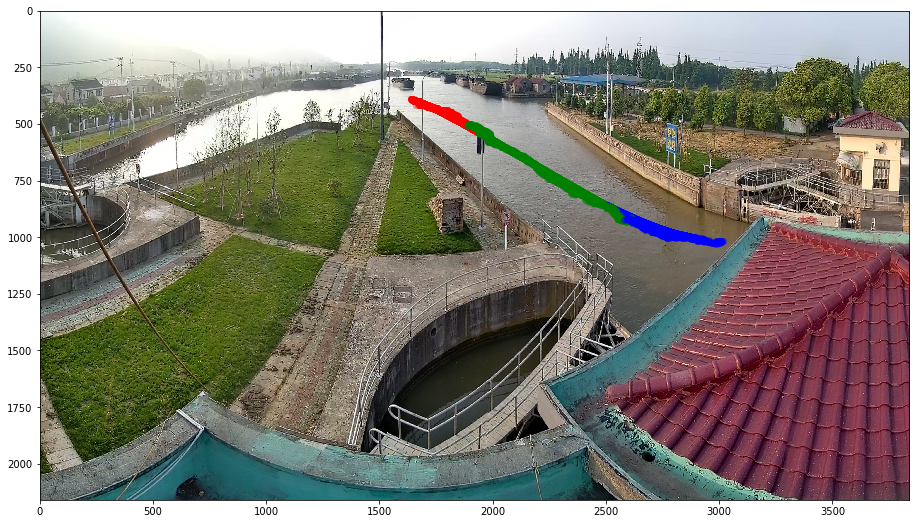

1429


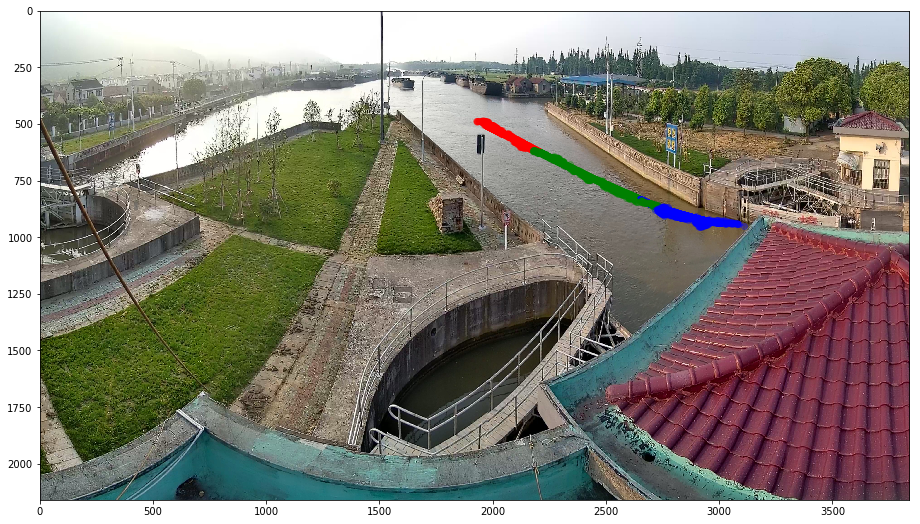

906


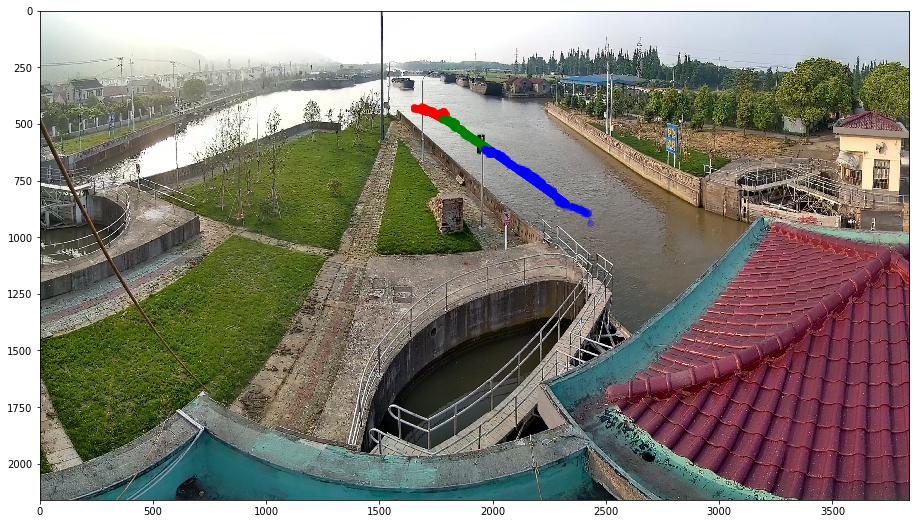

658


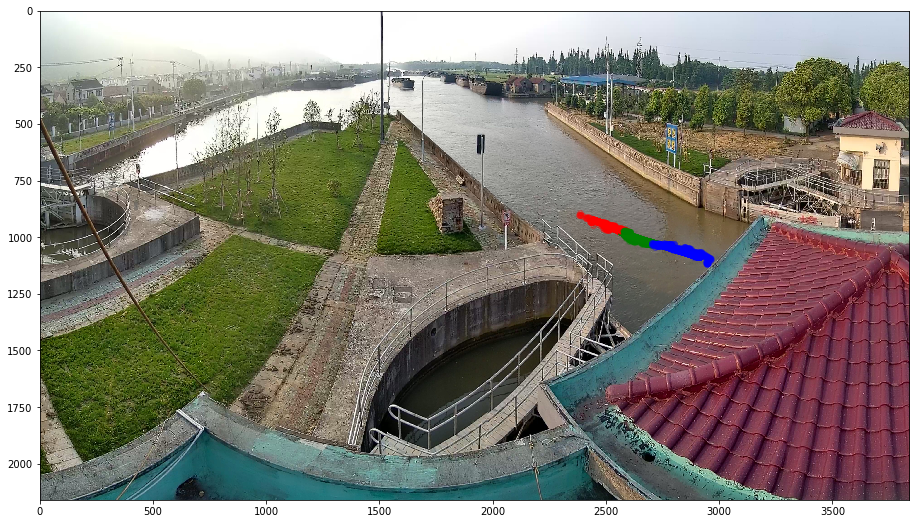

216


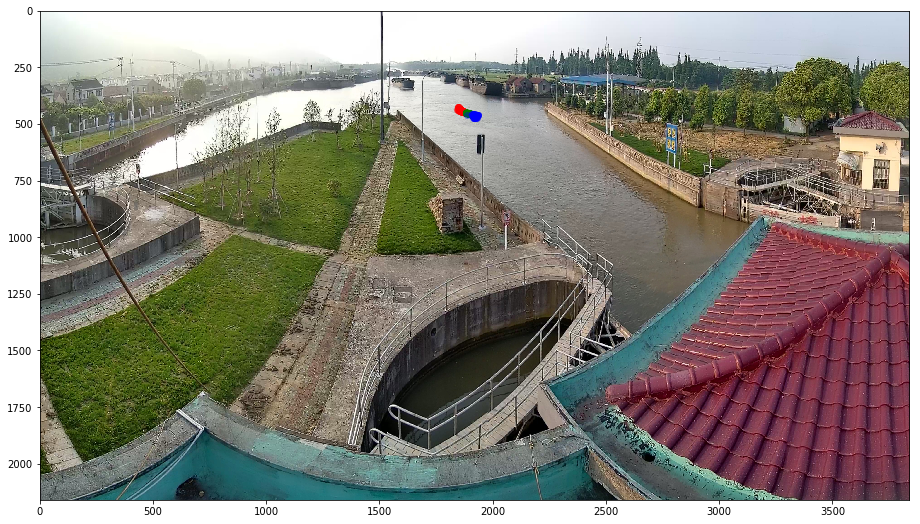

In [15]:
for chain in sorted([chain for chain in collected['chain_list']], reverse=True, key=len)[:5]:
    pt_arr = np.array([box['pt'] for box in chain])
    pt_smoothed_arr = np.array([box['pt_smoothed'] for box in chain])
    if len(pt_arr) <2:
        print('suppressed')
        continue
    print(len(pt_arr))
    x,y = pt_arr[:,::2].mean(axis=1),pt_arr[:,1::2].mean(axis=1)
    x_bar,y_bar = pt_smoothed_arr[:,::2].mean(axis=1),pt_smoothed_arr[:,1::2].mean(axis=1)
    
    plt.figure(figsize=(16,9))
    plot_trace(x_bar, y_bar)
    plot_trace(x,y, alpha=0.3)
    plt.imshow(background)
    plt.show()

In [16]:
def adaptive_chain_smoother(arr):
    n_K = max(len(arr) //3, 1)
    K = np.ones(n_K)/n_K
    return convolve(arr, K, mode ='nearest')

collected = collect_predict("output003_cache_split", pixel_threshold = 60, verbose=True,
                    K_size = 60, K_delta_size=40, chain_smoother = adaptive_chain_smoother)

58 chain detected


2907


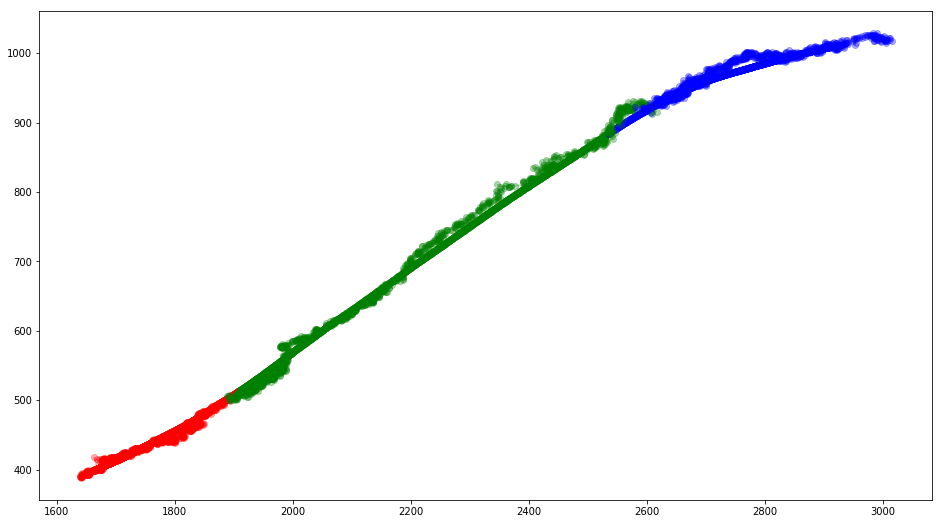

1429


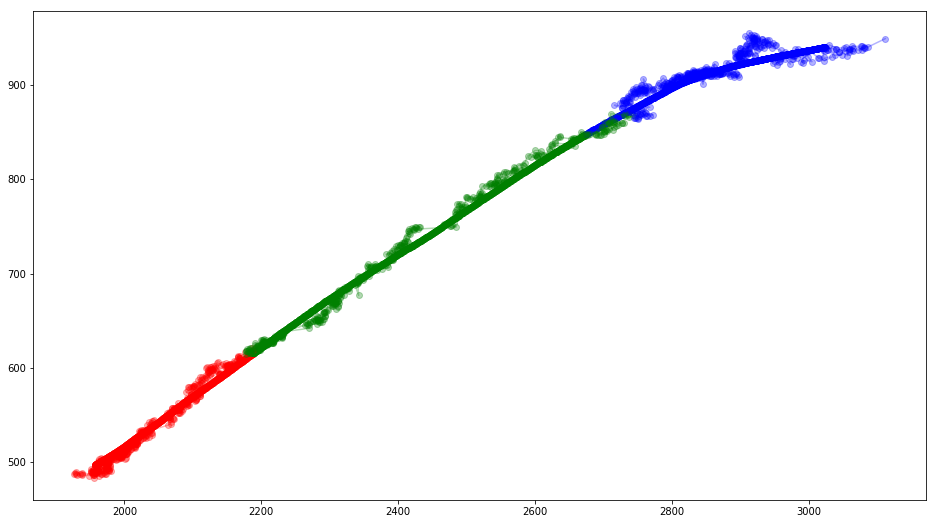

906


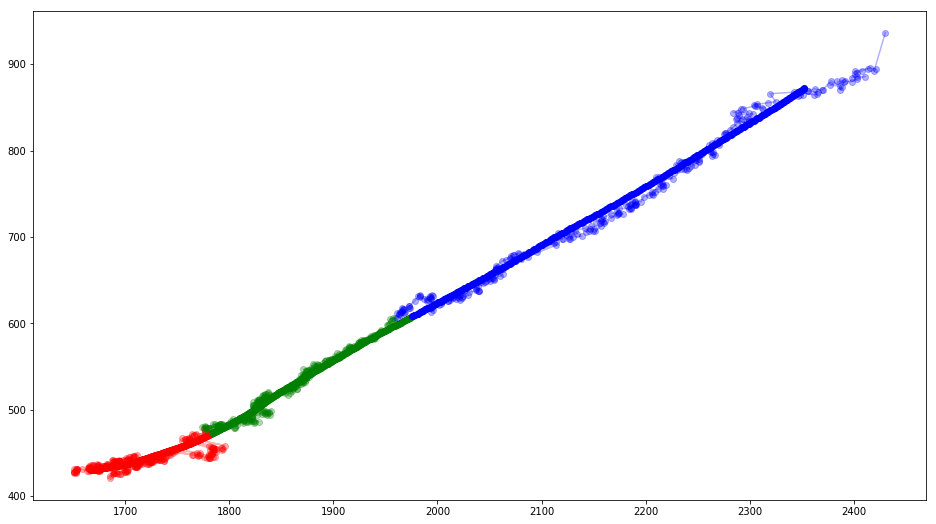

658


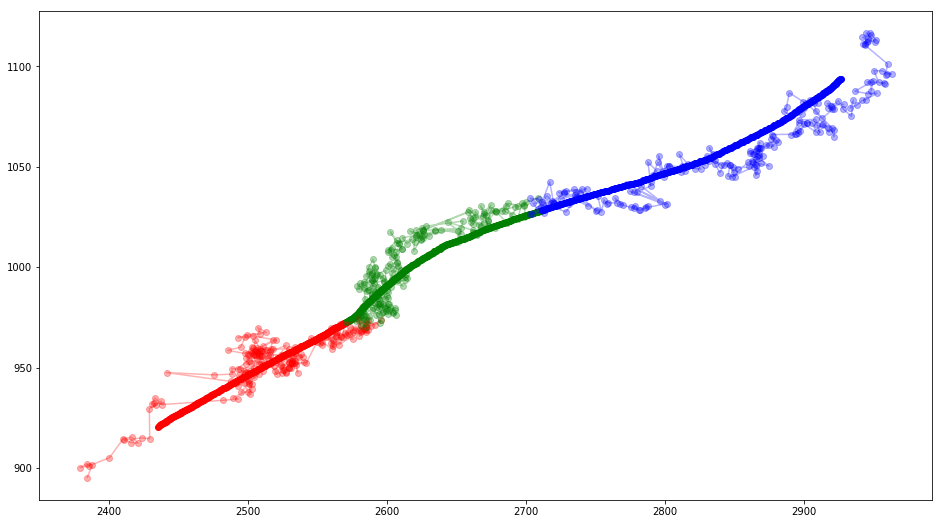

216


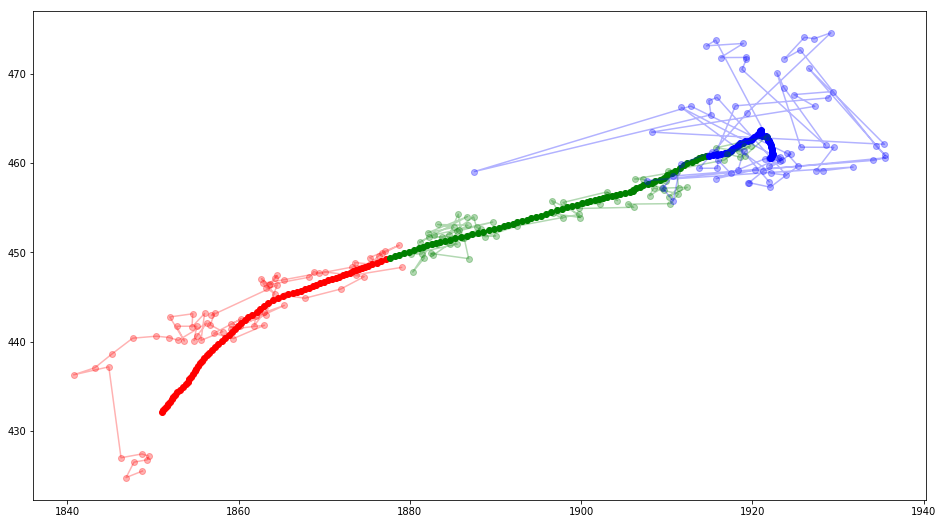

In [17]:
for chain in sorted([chain for chain in collected['chain_list']], reverse=True, key=len)[:5]:
    pt_arr = np.array([box['pt'] for box in chain])
    pt_smoothed_arr = np.array([box['pt_smoothed'] for box in chain])
    if len(pt_arr) <2:
        print('suppressed')
        continue
    print(len(pt_arr))
    x,y = pt_arr[:,::2].mean(axis=1),pt_arr[:,1::2].mean(axis=1)
    x_bar,y_bar = pt_smoothed_arr[:,::2].mean(axis=1),pt_smoothed_arr[:,1::2].mean(axis=1)
    
    plt.figure(figsize=(16,9))
    plot_trace(x_bar, y_bar)
    plot_trace(x,y, alpha=0.3)
    plt.show()

2907


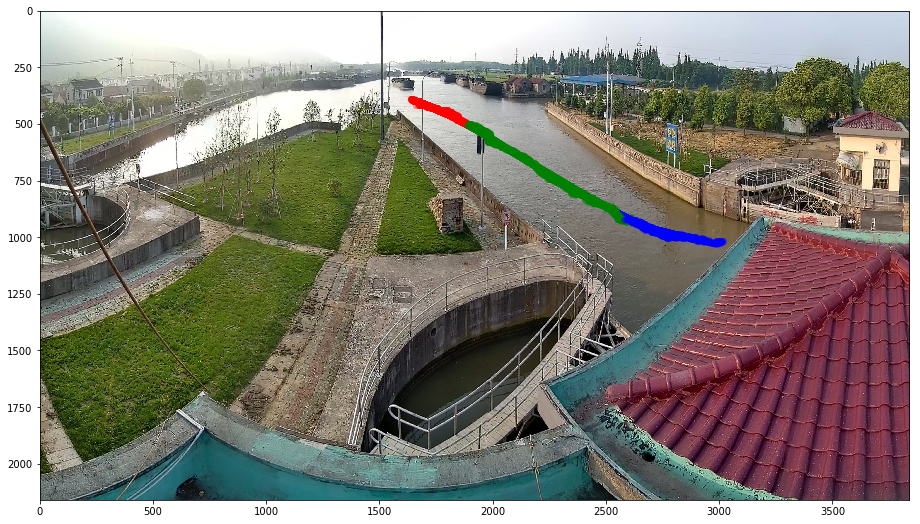

1429


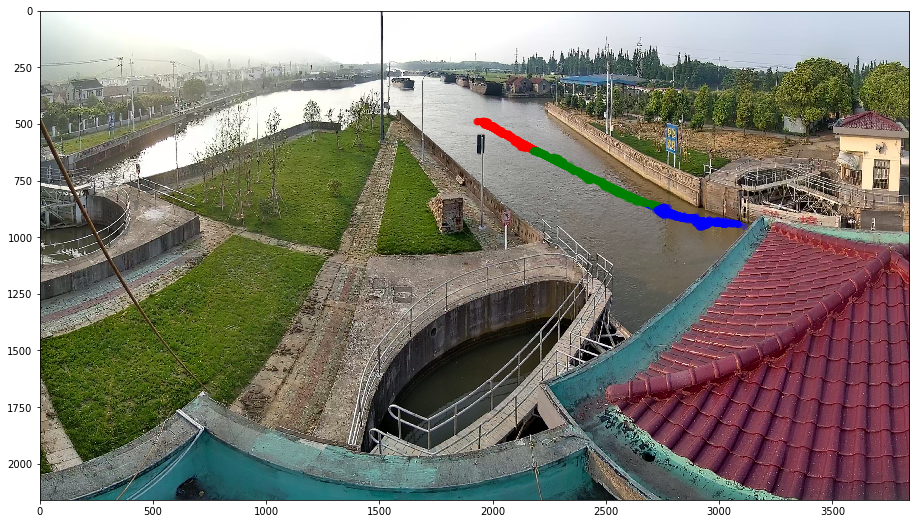

906


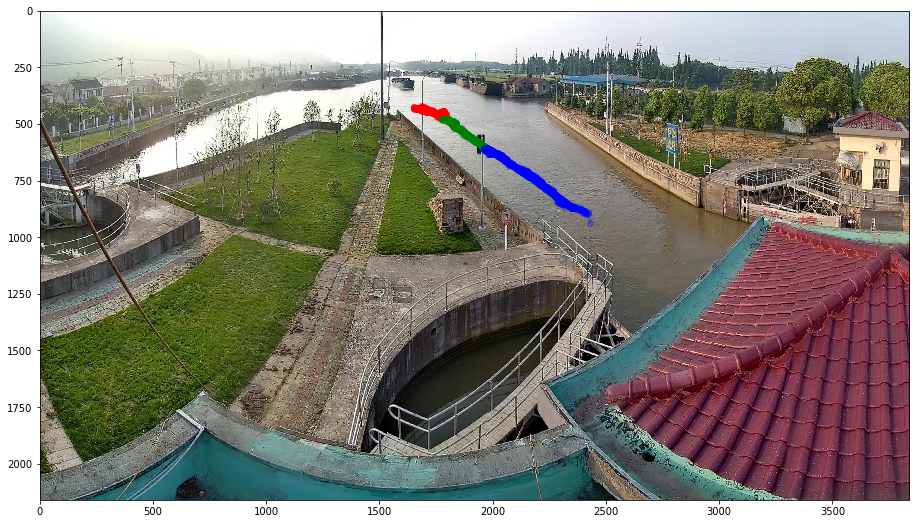

658


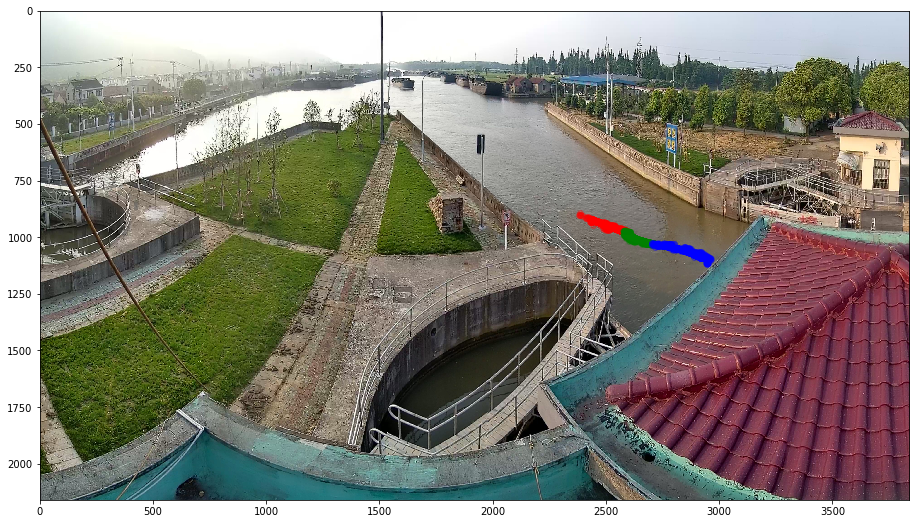

216


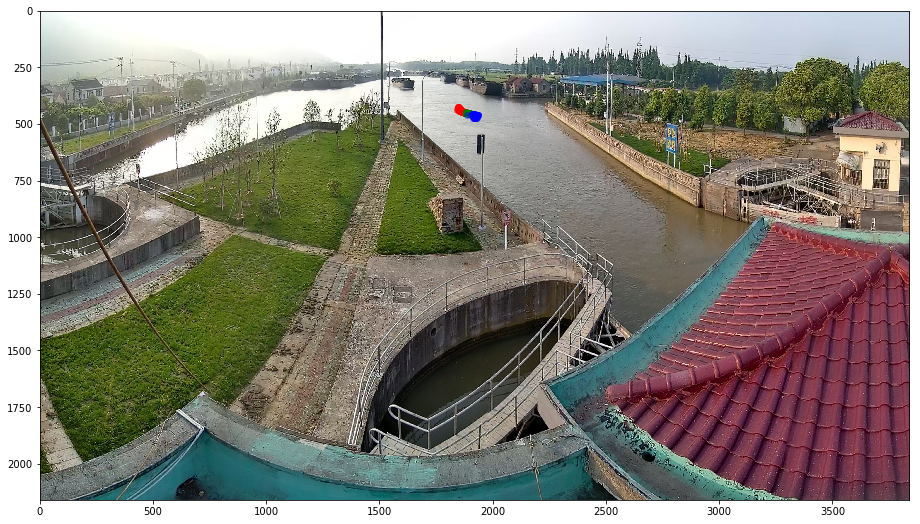

In [18]:
for chain in sorted([chain for chain in collected['chain_list']], reverse=True, key=len)[:5]:
    pt_arr = np.array([box['pt'] for box in chain])
    pt_smoothed_arr = np.array([box['pt_smoothed'] for box in chain])
    if len(pt_arr) <2:
        print('suppressed')
        continue
    print(len(pt_arr))
    x,y = pt_arr[:,::2].mean(axis=1),pt_arr[:,1::2].mean(axis=1)
    x_bar,y_bar = pt_smoothed_arr[:,::2].mean(axis=1),pt_smoothed_arr[:,1::2].mean(axis=1)
    
    plt.figure(figsize=(16,9))
    plot_trace(x_bar, y_bar)
    plot_trace(x,y, alpha=0.3)
    plt.imshow(background)
    plt.show()

我们尝试允许往后跳一定数量的unmatched的frame来使得chain们能够连起来，能连起来再加上大幅度平滑很多问题就自动解决了（当然另一方面禁止跳连也使得大误差被控制在一定范围内而不会因为权重去影响其他chain，所以允许跳连后必须使用更强的平滑）。当然这种chain连起来后
平滑的方式应该修改一下（如缺失的格权重置0，其他格均匀的提升使权向量合一），不过不改应该也不会产生太大偏差。

跳连可能有一些误差相关的问题使得跳连用在一阶段平滑后可能更好，比如1虽然本来应该与2相连，却因为噪声没连上，而跳连连上了3，这样再次
扫描到2时2就会往更后连，导致非常混乱的情况发生，而禁止跳连起码不会发生这种情况。

不过允许跳连也使得通过平滑来插值补充一些检测算法没检测到的框成为可能。所以还是可以考虑的。

In [19]:
def adaptive_chain_smoother(arr):
    n_K = max(len(arr) //3, 1)
    K = np.ones(n_K)/n_K
    return convolve(arr, K, mode ='nearest')

collected = collect_predict("output003_cache_split", pixel_threshold = 60, verbose=True,
                    K_size = 60, K_delta_size=40, chain_smoother = adaptive_chain_smoother, jump_tol = 10)

12 chain detected


3271


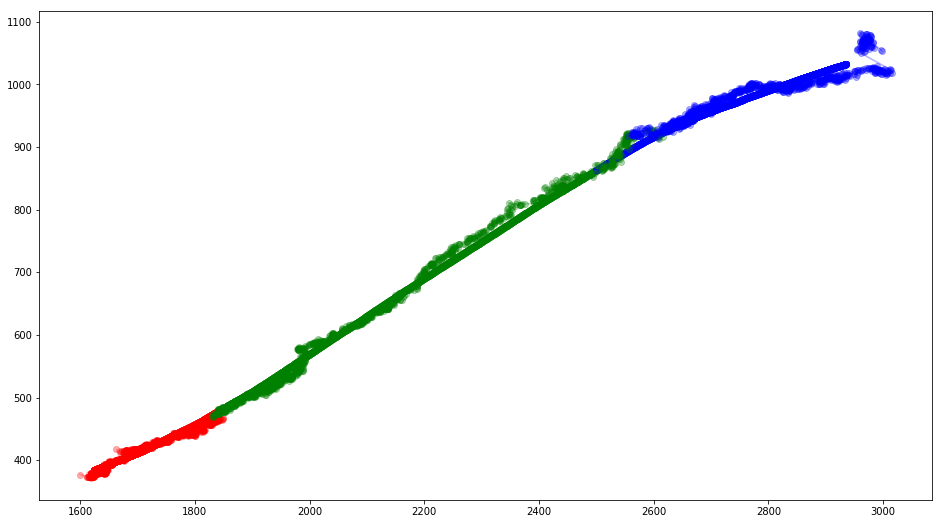

1862


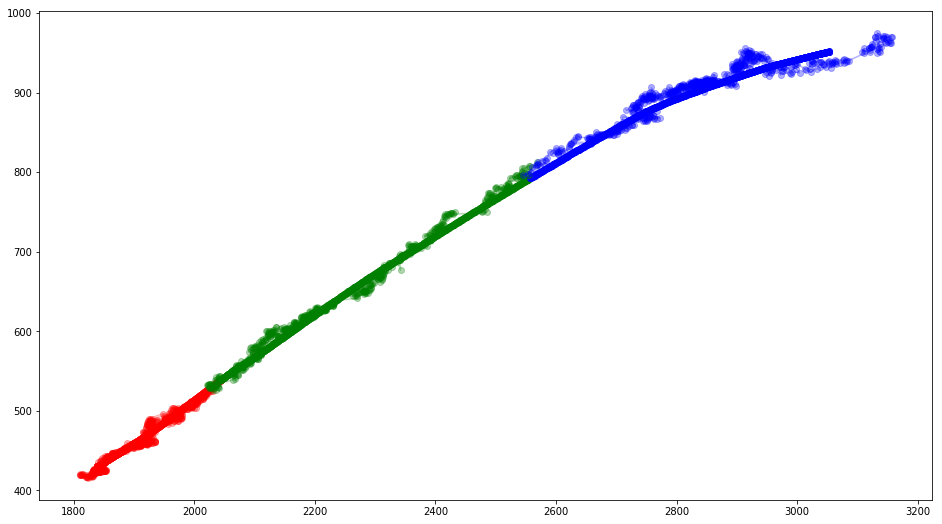

1574


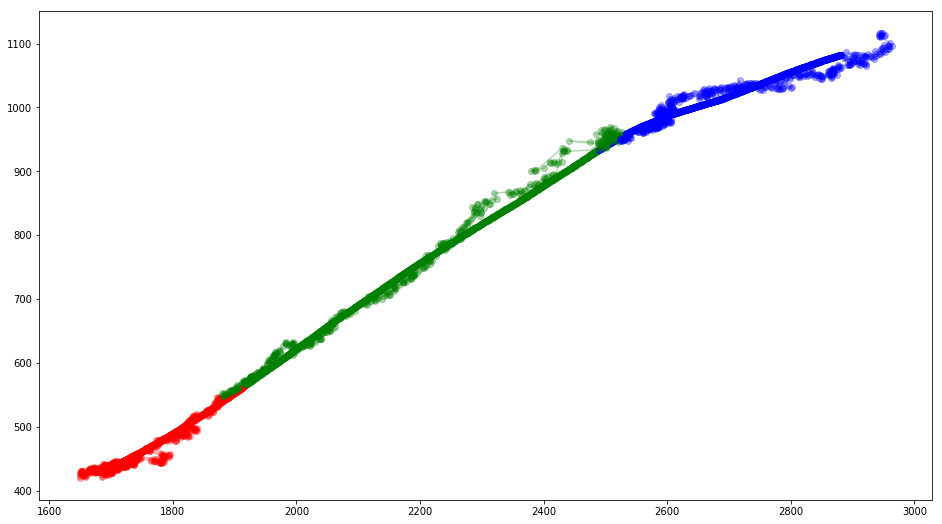

37


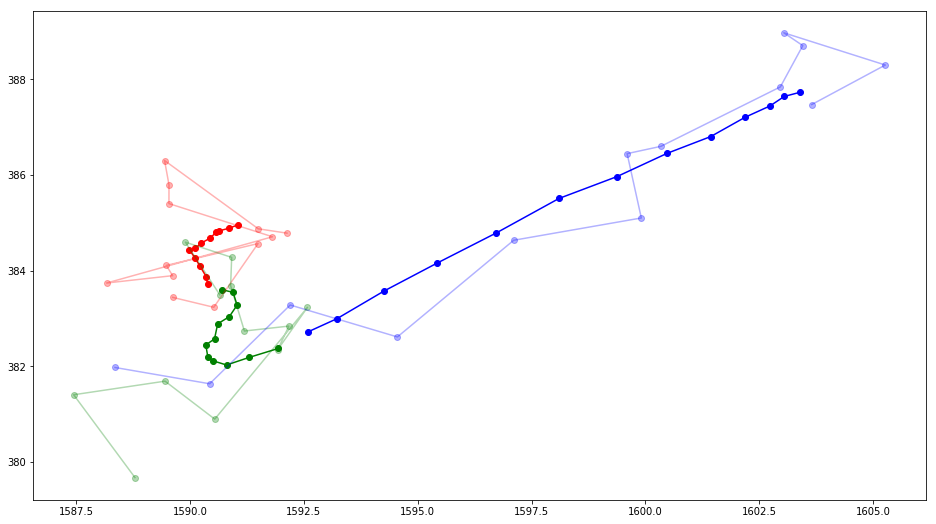

11


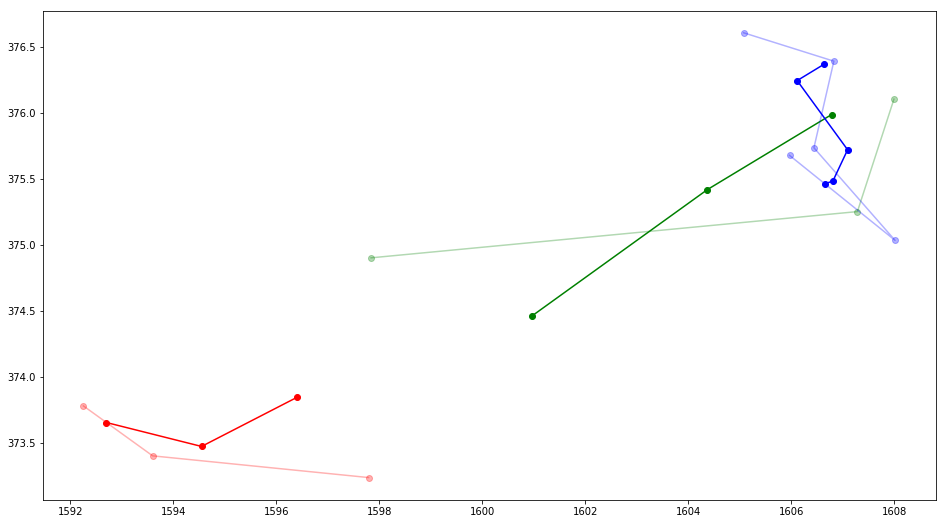

In [20]:
for chain in sorted([chain for chain in collected['chain_list']], reverse=True, key=len)[:5]:
    pt_arr = np.array([box['pt'] for box in chain])
    pt_smoothed_arr = np.array([box['pt_smoothed'] for box in chain])
    if len(pt_arr) <2:
        print('suppressed')
        continue
    print(len(pt_arr))
    x,y = pt_arr[:,::2].mean(axis=1),pt_arr[:,1::2].mean(axis=1)
    x_bar,y_bar = pt_smoothed_arr[:,::2].mean(axis=1),pt_smoothed_arr[:,1::2].mean(axis=1)
    
    plt.figure(figsize=(16,9))
    plot_trace(x_bar, y_bar)
    plot_trace(x,y, alpha=0.3)
    plt.show()